**References:** 
- Image Manipulation in Python - A complete guide to Pillow [https://youtube.com/watch?v=5QR-dG68eNE]

## Imports

In [446]:
from PIL import Image
import os

In [447]:
source_dir = 'images-jpg'
file_name = 'strawberry.jpg'

In [448]:
with Image.open(f'{source_dir}/{file_name}') as image:
    print(type(image))
    print(type(image.load()))

<class 'PIL.JpegImagePlugin.JpegImageFile'>
<class 'PixelAccess'>


## Basic Image Operations

In [449]:
target_dir = 'images-png'
image.save(f'{target_dir}/{os.path.splitext(file_name)[0]}.png')

In [450]:
print(
    image.size, '\n',
    image.filename, '\n',
    image.format, '\n', 
    image.format_description, '\n', 
    image.mode, '\n', 
    image.getbands()
)

(1920, 1281) 
 images-jpg/strawberry.jpg 
 JPEG 
 JPEG (ISO 10918) 
 RGB 
 ('R', 'G', 'B')


In [451]:
image.info

{'jfif': 257,
 'jfif_version': (1, 1),
 'jfif_unit': 0,
 'jfif_density': (1, 1),
 'progressive': 1,
 'progression': 1}

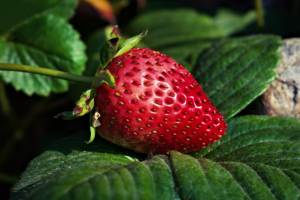

In [452]:
small_image = image.copy()
small_image.thumbnail((300, 300))
display(small_image)

In [453]:
image.size

(1920, 1281)

In [454]:
small_image.size

(300, 200)

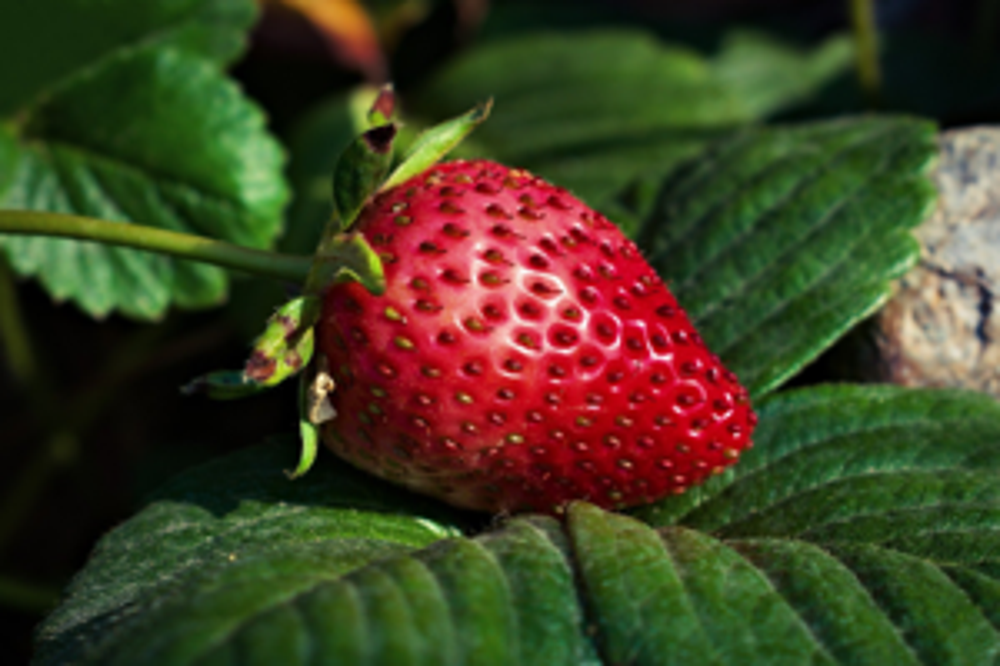

In [455]:
scaling_factor = 9
small_to_big = small_image.resize((small_image.width * scaling_factor, small_image.height * scaling_factor))
display(small_to_big)

In [456]:
small_to_big.size

(2700, 1800)

## Basic Image Manipulation

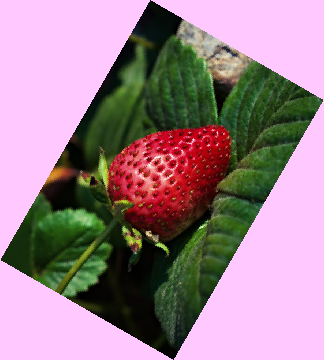

In [457]:
#Rotate

small_image.rotate(60, expand=True, fillcolor=(255, 200, 255))

In [458]:
from PIL import ImageColor
ImageColor.getcolor('pink', 'RGB')

(255, 192, 203)

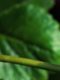

In [459]:
#Crop

left_x, top_y, right_x, bottom_y = 20, 10, 80, 90
small_image.crop((left_x, top_y, right_x, bottom_y))

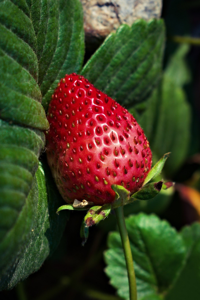

In [460]:
# Transpose

small_image.transpose(Image.Transpose.TRANSVERSE)
#Options: FLIP_LEFT_RIGHT, FLIP_TOP_BOTTOM, ROTATE_90, ROTATE_180, ROTATE_270, TRANSPOSE, TRANSVERSE

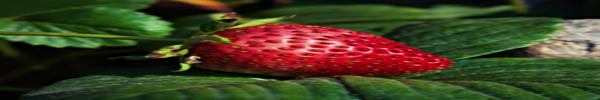

In [461]:
#Resize
small_image.resize((600, 100))

## Filter and Image Enhancements

Pillow can change vibrance, contrast, brightness, and sharpness using ImageEnchance

And it can blur, contour, emboss, sharpening etc using Filters (there are a lot of those)

### Enhancements

In [462]:
from PIL import ImageEnhance

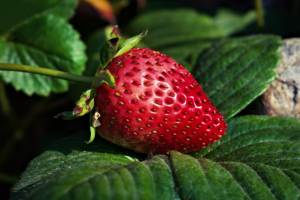

In [463]:
small_image

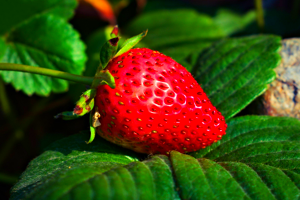

In [464]:
color_enchancer = ImageEnhance.Color(small_image)
color_enchancer.enhance(2)

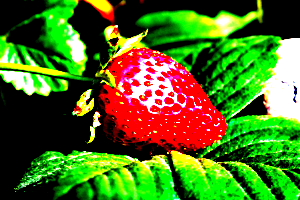

In [465]:
contrast_enchancer = ImageEnhance.Contrast(small_image)
contrast_enchancer.enhance(8)

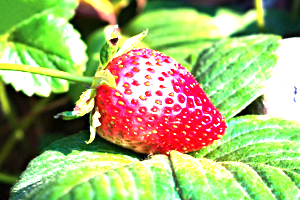

In [466]:
brightness_enchancer = ImageEnhance.Brightness(small_image)
brightness_enchancer.enhance(4)

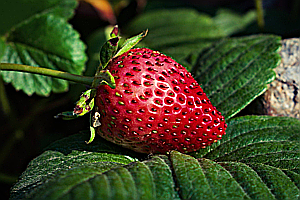

In [467]:
sharpness_enchancer = ImageEnhance.Sharpness(small_image)
sharpness_enchancer.enhance(6)

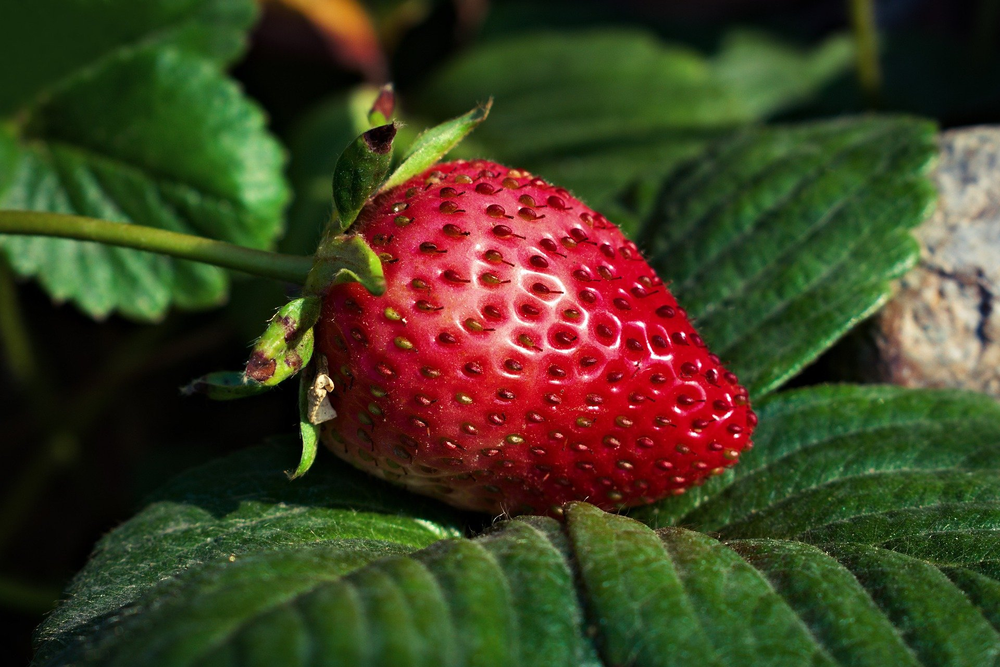

In [468]:
image

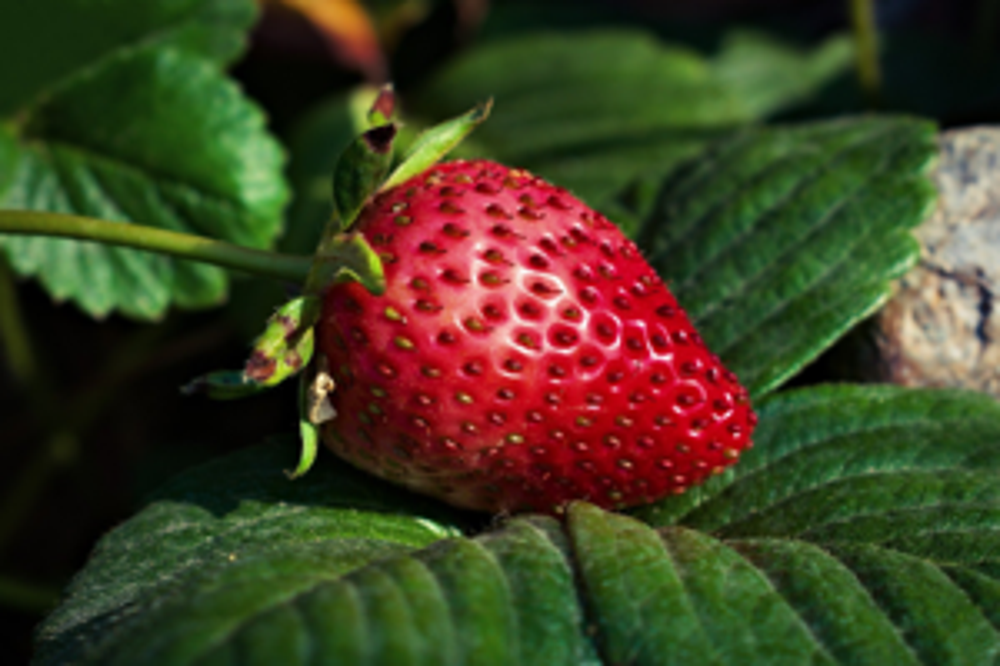

In [469]:
small_to_big

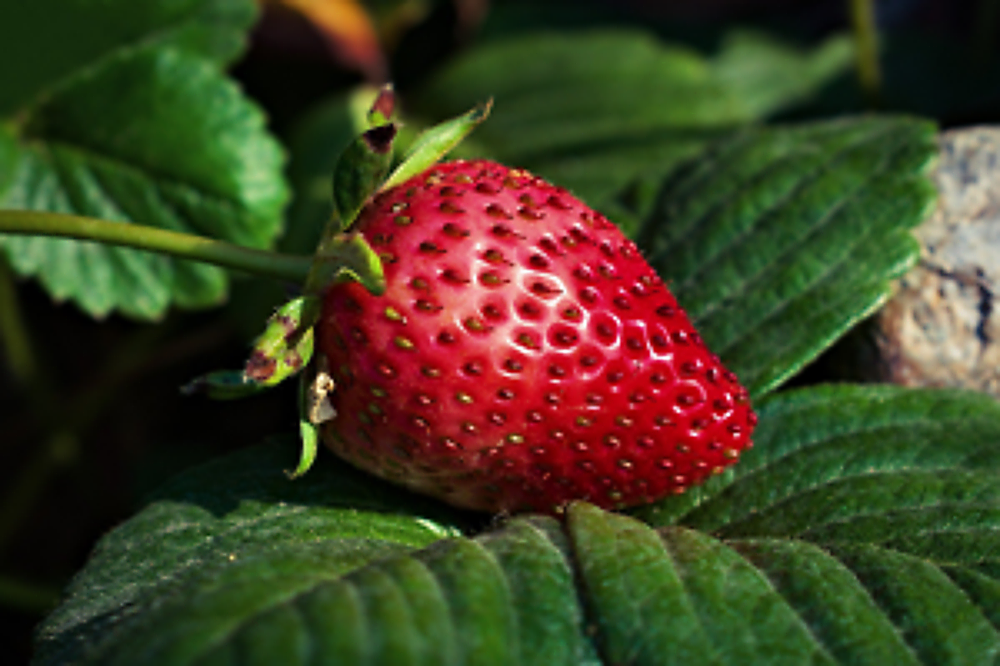

In [470]:
ImageEnhance.Sharpness(small_to_big).enhance(32)

### Filters

In [471]:
from PIL import ImageFilter

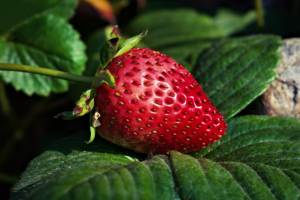

In [472]:
small_image

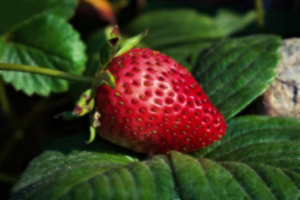

In [473]:
#Basic Filters
small_image.filter(ImageFilter.SMOOTH_MORE)
#Filters: BLUR, CONTOUR, DETAIL, EDGE_ENHANCE, EDGE_ENCHANCE_MORE, FIND_EDGES, EMBOSS, SHARPEN, SMOOTH, SMOOTH_MORE

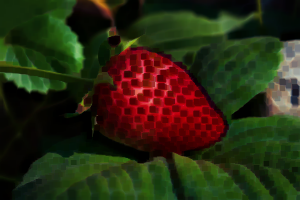

In [474]:
#Rank Filters
small_image.filter(ImageFilter.MinFilter(size=5))
#Filters: MinFilter, MaxFilter, MedianFilter

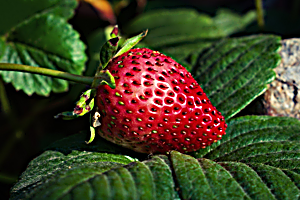

In [475]:
#Multiband
small_image.filter(ImageFilter.UnsharpMask(radius=2))
#Filters: BoxBluer, GaussianBlur, UnSharpMask

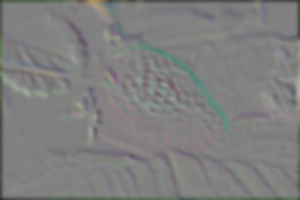

In [476]:
small_image.filter(ImageFilter.EMBOSS).filter(ImageFilter.GaussianBlur(radius=2))

## Colors in Pillow

Pillow can access and change colors
It can also changethe format of the image
But to understand how it works we need some theory

In [477]:
from collections import namedtuple

Pixel = namedtuple("Pixel", "x y")
selected_pixel = Pixel(2, 4)
small_image.getpixel(selected_pixel)

(18, 42, 10)

In [478]:
n_colors = small_image.getcolors(maxcolors= small_image.width * small_image.height)
print(len(n_colors))
print(n_colors[6])

44417
(2, (17, 37, 10))


In [479]:
red_channel = small_image.getchannel('R')
type(red_channel)

PIL.Image.Image

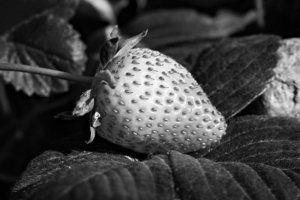

In [480]:
red_channel

In [481]:
red_channel.mode

'L'

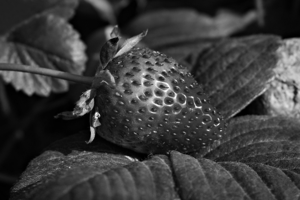

In [482]:
small_image.convert('L')

In [483]:
import numpy as np

In [484]:
print(np.array(small_image).shape)
print(np.array(small_image.getchannel('R')).shape)

(200, 300, 3)
(200, 300)


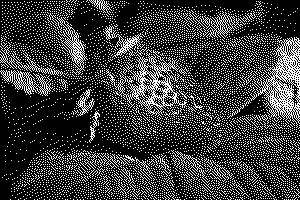

In [485]:
small_image.convert('1') #1-bit grayscale

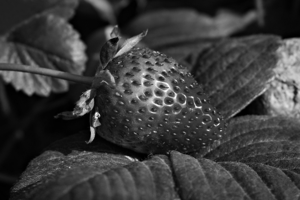

In [486]:
small_image.convert('L') #8-bit grayscale

### Palettes

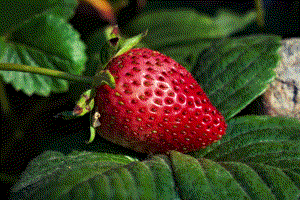

In [487]:
small_image.convert('P') #Palette

In [488]:
len(small_image.convert('P').getcolors())

98

In [489]:
small_image.convert('P').getbands()

('P',)

In [490]:
# small_image.convert('P').getpalette()

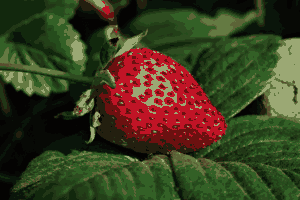

In [491]:
small_image_paletted = small_image.convert('P', palette=Image.Palette.ADAPTIVE, colors=16)
small_image_paletted

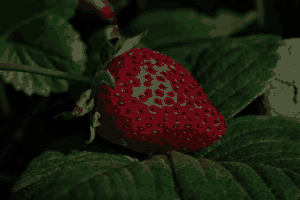

In [492]:
#update the color palette
new_palette = [x//2 for x in small_image_paletted.getpalette()]
small_image_paletted.putpalette(new_palette)
small_image_paletted

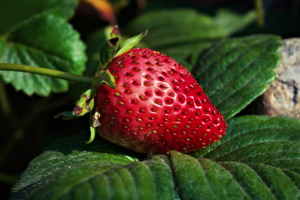

In [493]:
temp_image = small_image.copy()
temp_image.putpixel((10, 20), (255, 0, 0))
temp_image

## ImageOps

In [494]:
from PIL import ImageOps

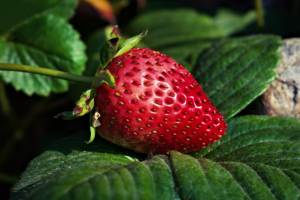

In [495]:
small_image

### Color Changes

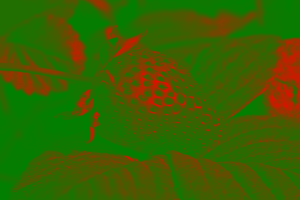

In [496]:
ImageOps.autocontrast(image=small_image, cutoff=2)
ImageOps.invert(small_image)
ImageOps.solarize(small_image, threshold=100)
ImageOps.posterize(small_image, bits=2)
ImageOps.grayscale(small_image)
ImageOps.equalize(small_image)
ImageOps.colorize(image=small_image.convert('L'), black='green', white='red')

### Dimension Changes

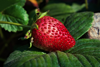

In [497]:
ImageOps.mirror(small_image)
ImageOps.flip(small_image)
ImageOps.scale(small_image, factor=0.4)
ImageOps.contain(small_image, size=(100, 200))

### Adding or Removing

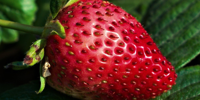

In [498]:
ImageOps.expand(small_image, border=20, fill=(255, 255, 0))
ImageOps.pad(small_image, size=(1500, 800))
ImageOps.fit(small_image, size=(100, 100))
ImageOps.crop(small_image, border=50)

## Deformer

In [499]:
import math
class WaveDeformer:

    def transform(self, x, y):
        y = y + 10*math.sin(x/40)
        return x, y

    def transform_rectangle(self, x0, y0, x1, y1):
        return (*self.transform(x0, y0),
                *self.transform(x0, y1),
                *self.transform(x1, y1),
                *self.transform(x1, y0),
                )

    def getmesh(self, img):
        self.w, self.h = img.size
        gridspace = 20

        target_grid = []
        for x in range(0, self.w, gridspace):
            for y in range(0, self.h, gridspace):
                target_grid.append((x, y, x + gridspace, y + gridspace))

        source_grid = [self.transform_rectangle(*rect) for rect in target_grid]

        return [t for t in zip(target_grid, source_grid)]

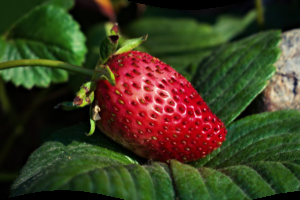

In [500]:
ImageOps.deform(small_image, WaveDeformer())

## Drawing Shapes

In [501]:
from PIL import ImageDraw

In [502]:
new_small_image = small_image.copy()
draw = ImageDraw.Draw(new_small_image)
draw

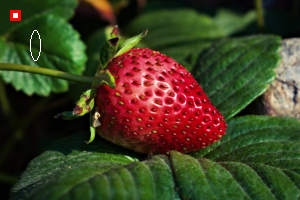

In [505]:
draw.rectangle((10, 10, 20, 20), fill='white', outline='red', width=3)
new_small_image

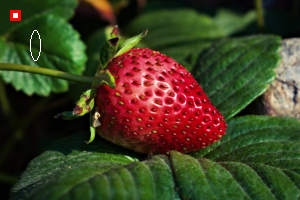

In [506]:
draw.ellipse((30, 30, 40, 60))
new_small_image

## Combining Images + ImageChops

## Masks